## Studying the thermalization and solitons  in the FPUT problem
(https://arxiv.org/pdf/nlin/0501053)

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp
from numpy.fft import fft

Derivation of soliton solution to the $\alpha$-FPUT problem using limits.


C:\Users\Conrad\AppData\Local\Temp\ipykernel_10764\600863842.py:96: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


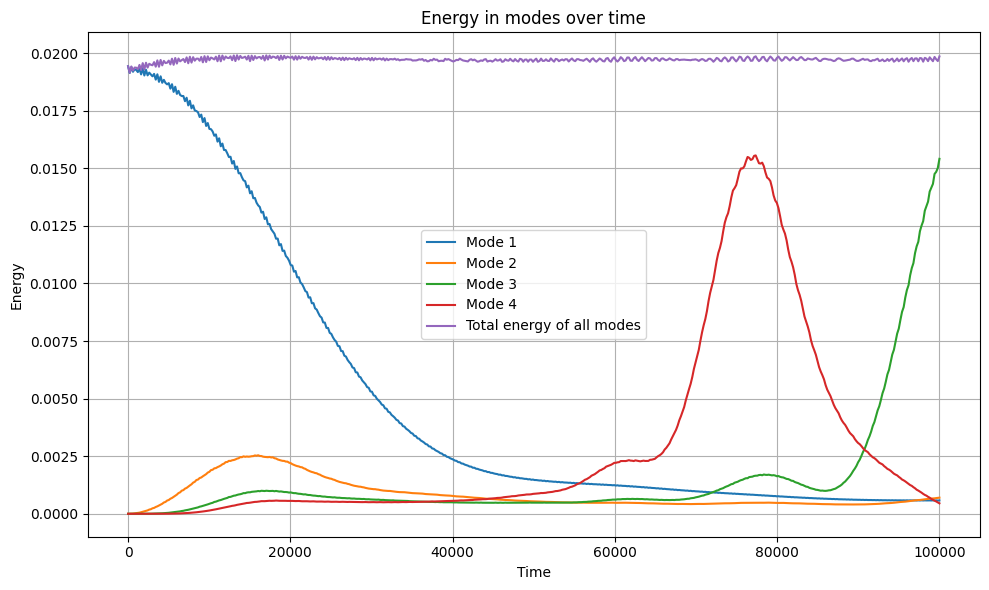

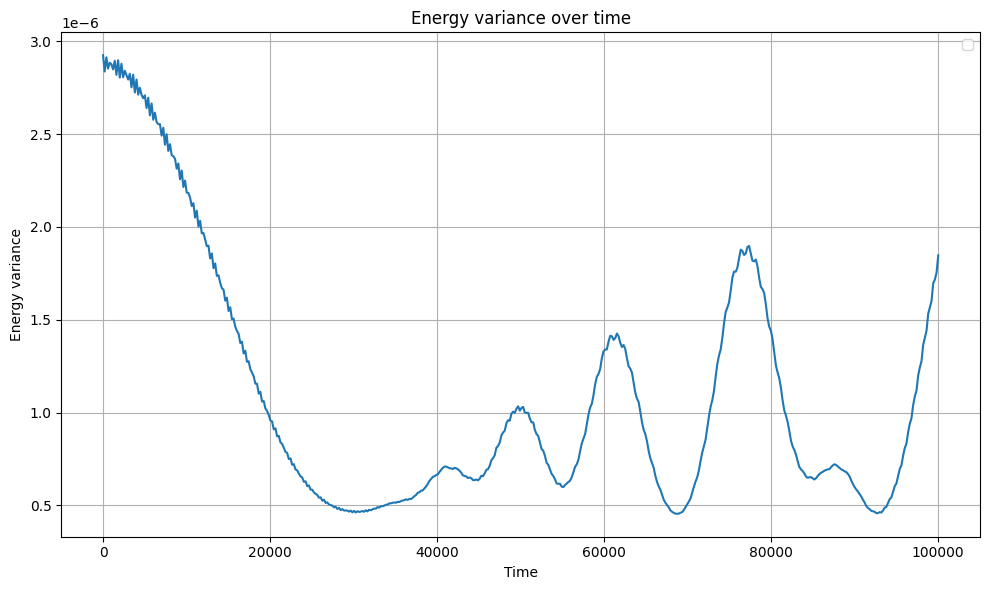

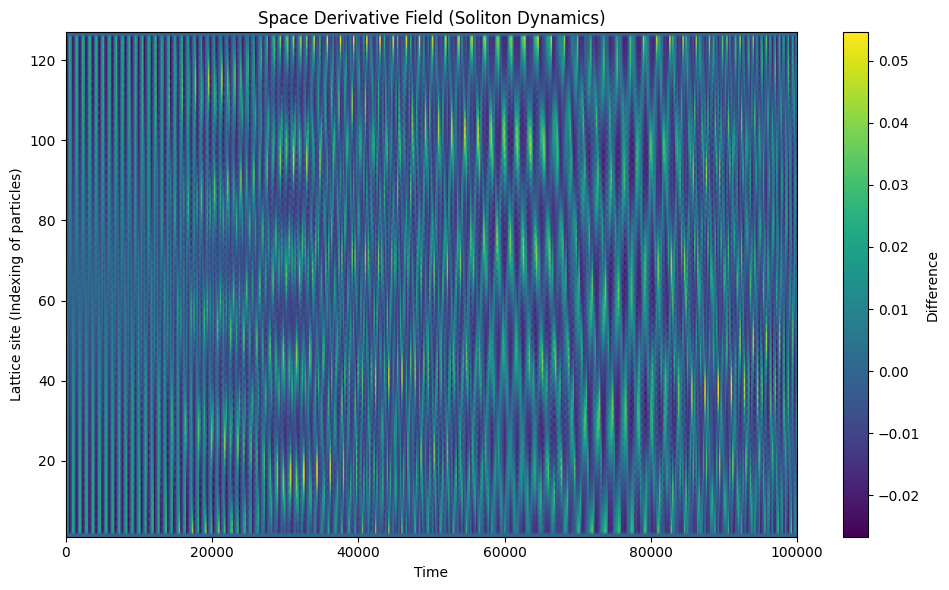

In [5]:
"""Translated to Python"""

N = 128
alpha = 0.25
# FPU Initial condition
TMAX = 1e5
DT = 200
# Zabusky-Deem Initial condition
# TMAX = 1e2
# DT = 0.1
tspan = np.linspace(0,TMAX,int(TMAX//DT)) # Time array in steps of DT

b = np.zeros(2*N) # State vector of (positions, velocities)

omegak2 = np.zeros(N) # Mode frequencies vector

for i in range(1,N+1):
    # FPU Initial condition
    a = 1
    b[i-1] = a*np.sin(np.pi*i/(N+1)) # Chain starts as half-sinewave
    b[i-1+N] = 0 # Velocities at 0
    
    # Solitons
    # Starts the initial velocities and displacements based on known soliton solution
    # k=0.8
    # sk=np.sinh(k)**2
    # ek=np.exp(-k)
    # i1=i-N/4
    # i2=i1-N/2
    # b[i-1] = -0.5/alpha*np.log((1+np.exp(2*k*(i1-1)))/(1+np.exp(2*k*i1)))
    # b[i-1] += 0.5/alpha*np.log((1+np.exp(2*k*(i2-1)))/(1+np.exp(2*k*i2)))
    # b[i-1+N] = sk*ek/alpha/np.cosh(k*i1)/(np.exp(-k*i1)+np.exp(k*i1)*np.exp(-2*k))
    # b[i-1+N] -= sk*ek/alpha/np.cosh(k*i2)/(np.exp(-k*i2)+np.exp(k*i2)*np.exp(-2*k))

    # Mode Frequencies
    # Equivalent to w(k) = 2 - 2cos(2 pi k/N)
    omegak2[i-1]=4*(np.sin(np.pi*i/2/N))**2

def fpu1(t,y):
    # Takes in the state vector y and returns dy/dt
    
    D = np.zeros_like(y)
    D[:N] = y[N:] # D[0:N] are dq/dt = v, the velocities
    D[N] = y[1] - 2*y[0] + alpha * ((y[1] - y[0])**2 - y[0]**2) # Applying FPUT equation for acceleration 
    D[2*N-1] = y[N-2] - 2*y[N-1] + alpha * (y[N-1]**2 - (y[N-1] - y[N-2])**2) # Applying FPUT equation for acceleration
    
    for i in range(1, N-1):
        D[N+i] = y[i+1] + y[i-1] - 2*y[i] + alpha * ((y[i+1] - y[i])**2 - (y[i] - y[i-1])**2) # Applying FPUT equation for acceleration
    return D

sol = solve_ivp(fpu1, [0, TMAX], b, t_eval=tspan, rtol=1e-4)
Y = sol.y.T

TIME = tspan

# Adding boundary nodes that are fixed at 0
YX = np.hstack([np.zeros((len(tspan), 1)), Y[:, :N]])  
YV = np.hstack([np.zeros((len(tspan), 1)), Y[:, N:]])

# Imaginary part of the discrete fourier transform on displacement
# Amplitude of modes' displacements 
sXF = np.imag(fft(np.hstack([YX, np.zeros((len(tspan), 1)), -YX[:, N:0:-1]]), axis=1)) / np.sqrt(2 * (N + 1))
# Imaginary part of the discrete fourier transform on velocity
# Amplitude of modes' velocities
sVF = np.imag(fft(np.hstack([YV, np.zeros((len(tspan), 1)), -YV[:, N:0:-1]]), axis=1)) / np.sqrt(2 * (N + 1))

# Energy over time for each fourier mode based on the imaginary parts of fft.
Energ = np.zeros((len(tspan), N))
for it in range(len(tspan)):
    Energ[it, :] = 0.5 * (omegak2 * sXF[it, 1:N+1]**2 + sVF[it, 1:N+1]**2)

# Derivatives to visualize soliton field
DifY = np.zeros((len(tspan), N))
for it in range(len(tspan)):
    for j in range(1, N-1):
        DifY[it, j] = Y[it, j+1] - Y[it, j]

# Plot energy distribution
plt.figure(figsize=(10, 6))
for k in range(4):
    plt.plot(TIME, Energ[:, k], label=f'Mode {k+1}')
plt.plot(TIME, np.sum(Energ,axis=1), label='Total energy of all modes')
plt.xlabel('Time')
plt.ylabel('Energy')
plt.title('Energy in modes over time')
plt.legend()
plt.grid()
plt.tight_layout()

# Plot of variance of mode energies
plt.figure(figsize=(10, 6))
plt.plot(TIME, np.var(Energ,axis=1))
plt.xlabel('Time')
plt.ylabel('Energy variance')
plt.title('Energy variance over time')
plt.legend()
plt.grid()
plt.tight_layout()

# Plot soliton field
plt.figure(figsize=(10, 6))
plt.imshow(DifY.T, aspect='auto', origin='lower', cmap='viridis', extent=[TIME[0], TIME[-1], 1, N-1])
plt.xlabel('Time')
plt.ylabel('Lattice site (Indexing of particles)')
plt.title('Space Derivative Field (Soliton Dynamics)')
plt.colorbar(label='Difference')
plt.tight_layout()
plt.show()

KeyboardInterrupt: 

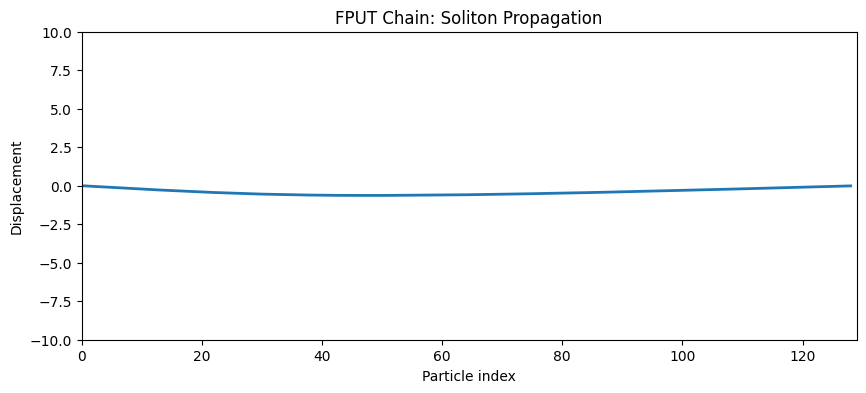

In [4]:
%matplotlib inline
from IPython.display import HTML
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Assuming YX is already created as:
# YX = np.hstack([np.zeros((len(tspan), 1)), Y[:, :N]])

fig, ax = plt.subplots(figsize=(10, 4))
line, = ax.plot([], [], lw=2)
ax.set_xlim(0, N + 1)
ax.set_ylim(-10, 10)  # Adjust based on your data range
ax.set_xlabel("Particle index")
ax.set_ylabel("Displacement")
ax.set_title("FPUT Chain: Soliton Propagation")

def init():
    line.set_data([], [])
    return line,

def update(frame):
    line.set_data(np.arange(N + 1), YX[frame])
    return line,

ani = FuncAnimation(fig, update, frames=len(YX), init_func=init,
                    blit=True, interval=30)

# Display the animation in Jupyter
HTML(ani.to_jshtml())

Animation size has reached 21003925 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


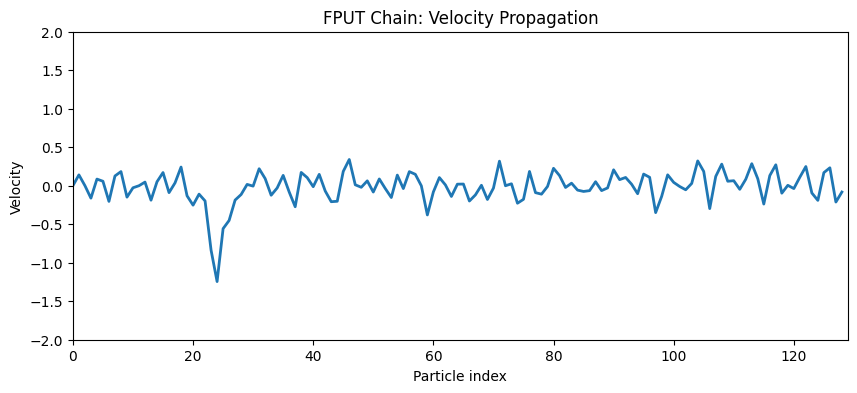

In [ ]:
%matplotlib inline
from IPython.display import HTML
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import numpy as np

fig, ax = plt.subplots(figsize=(10, 4))
line, = ax.plot([], [], lw=2)
ax.set_xlim(0, N + 1)
ax.set_ylim(-2, 2)  # Adjust to your velocity amplitude range
ax.set_xlabel("Particle index")
ax.set_ylabel("Velocity")
ax.set_title("FPUT Chain: Velocity Propagation")

def init():
    line.set_data([], [])
    return line,

def update(frame):
    line.set_data(np.arange(N + 1), YV[frame])
    return line,

ani = FuncAnimation(fig, update, frames=len(YV), init_func=init,
                    blit=True, interval=30)

HTML(ani.to_jshtml())
